**Install libraries**

In [1]:
# Install libraries for Grad-CAM and dataset downloading
!pip install grad-cam kagglehub

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 68.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for grad-cam: filename=grad_cam-1.5.5-py3-none-any.whl size=44284 sha256=9a27281a80518b7302b320a9690643f74d4e08300cd293e9e5b7d201fcecace2
  Stored in directory: /root/.cache/pip/wheels/fb/3b/09/2afc520f3d69bc26ae6bd87416759c820a3f7d05c1a077bbf6
Successfully built grad-cam


In [2]:
import os
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torch.utils.data import DataLoader, Dataset, random_split
from torchvision import transforms, datasets, models
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image
import kagglehub

In [3]:
# Configuration
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
BATCH_SIZE = 16
EPOCHS = 5
LEARNING_RATE = 0.0001

print(f"Project running on: {DEVICE}")

Project running on: cuda


**Download dataset from Kaggle**

In [4]:
# Download the "44 Classes" brain tumor MRI dataset
path = kagglehub.dataset_download("fernando2rad/brain-tumor-mri-images-44c")
print("Data stored at:", path)

Using Colab cache for faster access to the 'brain-tumor-mri-images-44c' dataset.
Data stored at: /kaggle/input/brain-tumor-mri-images-44c


**Dataset loader and transforms**

In [5]:
class MRIModalityDataset(Dataset):
    def __init__(self, root, modality_suffix, transform=None):
        # Load all 44 folders
        self.full_ds = datasets.ImageFolder(root=root)

        # Filter for classes ending in the specified modality (e.g., " T1")
        self.indices = [i for i, name in enumerate(self.full_ds.classes) if name.endswith(modality_suffix)]
        self.class_names = [self.full_ds.classes[i] for i in self.indices]

        # Filter the actual file samples
        self.samples = [s for s in self.full_ds.samples if s[1] in self.indices]

        # Map original folder IDs to new sequential IDs for the model
        self.label_map = {old_idx: new_idx for new_idx, old_idx in enumerate(self.indices)}
        self.transform = transform

    def __len__(self):
        return len(self.samples)

    def __getitem__(self, idx):
        path, target = self.samples[idx]
        img = Image.open(path).convert('RGB')
        if self.transform:
            img = self.transform(img)
        return img, self.label_map[target]
# ImageNet-standard transformations
data_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

def get_modality_loaders(modality_suffix):
    dataset = MRIModalityDataset(path, modality_suffix, transform=data_transforms)

    # Split: 80% Training, 20% Validation
    train_size = int(0.8 * len(dataset))
    val_size = len(dataset) - train_size
    train_ds, val_ds = random_split(dataset, [train_size, val_size])

    train_loader = DataLoader(train_ds, batch_size=BATCH_SIZE, shuffle=True)
    val_loader = DataLoader(val_ds, batch_size=BATCH_SIZE, shuffle=False)

    return train_loader, val_loader, len(dataset.class_names), dataset.class_names, val_ds

**Model training function**

In [6]:
def train_model(loader, num_classes):
    model = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)
    model.fc = nn.Linear(model.fc.in_features, num_classes)
    model = model.to(DEVICE)

    optimizer = torch.optim.Adam(model.parameters(), lr=LEARNING_RATE)
    criterion = nn.CrossEntropyLoss()

    for epoch in range(EPOCHS):
        model.train()
        running_loss = 0.0
        for imgs, lbls in loader:
            imgs, lbls = imgs.to(DEVICE), lbls.to(DEVICE)
            optimizer.zero_grad()
            loss = criterion(model(imgs), lbls)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
        print(f"Epoch [{epoch+1}/{EPOCHS}], Loss: {running_loss/len(loader):.4f}")

    return model

In [7]:
def run_gradcam(model, dataset, class_names, num_samples=2):
    model.eval()
    target_layers = [model.layer4[-1]]
    cam = GradCAM(model=model, target_layers=target_layers)

    fig, axes = plt.subplots(num_samples, 2, figsize=(10, 5 * num_samples))
    for i in range(num_samples):
        idx = np.random.randint(0, len(dataset))
        img_tensor, label = dataset[idx]
        input_tensor = img_tensor.unsqueeze(0).to(DEVICE)

        # Target the specific label for the visualization
        targets = [ClassifierOutputTarget(label)]
        grayscale_cam = cam(input_tensor=input_tensor, targets=targets)[0, :]

        # Normalize for display
        img_show = img_tensor.permute(1, 2, 0).cpu().numpy()
        img_show = (img_show - img_show.min()) / (img_show.max() - img_show.min())
        vis = show_cam_on_image(img_show, grayscale_cam, use_rgb=True)

        axes[i, 0].imshow(img_show); axes[i, 0].set_title(f"Target: {class_names[label]}")
        axes[i, 1].imshow(vis); axes[i, 1].set_title("Grad-CAM Focus Area")
    plt.tight_layout(); plt.show()

**Main loop for training model and analysis**

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=55e2628444b742d8f968bf65312d3498abbad2cae6fd1fe513f96d7bf0281e4c
  Stored in directory: /root/.cache/pip/wheels/e7/5d/0e/4b4fff9a47468fed5633211fb3b76d1db43fe806a17fb7486a
Successfully built lime

🚀 RUNNING EXPERIMENT: T1
   Classes (15): ['Astrocitoma T1', 'Carcinoma T1', 'Ependimoma T1', 'Ganglioglioma T1', 'Germinoma T1', 'Glioblastoma T1', 'Granuloma T1', 'Meduloblastoma T1', 'Meningioma T1', 'Neurocitoma T1', 'Oligodendroglioma T1', 'Papiloma T1', 'Schwannoma T1', 'Tuberculoma T1', '_NORMAL T1']
   Train Size: 1138 | Val Size: 285
Epoch [1/5], Loss: 1.2078
Epoch [2/5], Loss: 0.3006
Epoch [3/5], Loss: 0.0948
Epoch [4/5], Loss: 0.0455
Epoch [5/5], Loss: 0.0692

🔍 STARTING COMPREHENSIVE ANALYSIS: T1
   Scanning validation set for Correct/Incorrect examples...

📊 Classification Repo

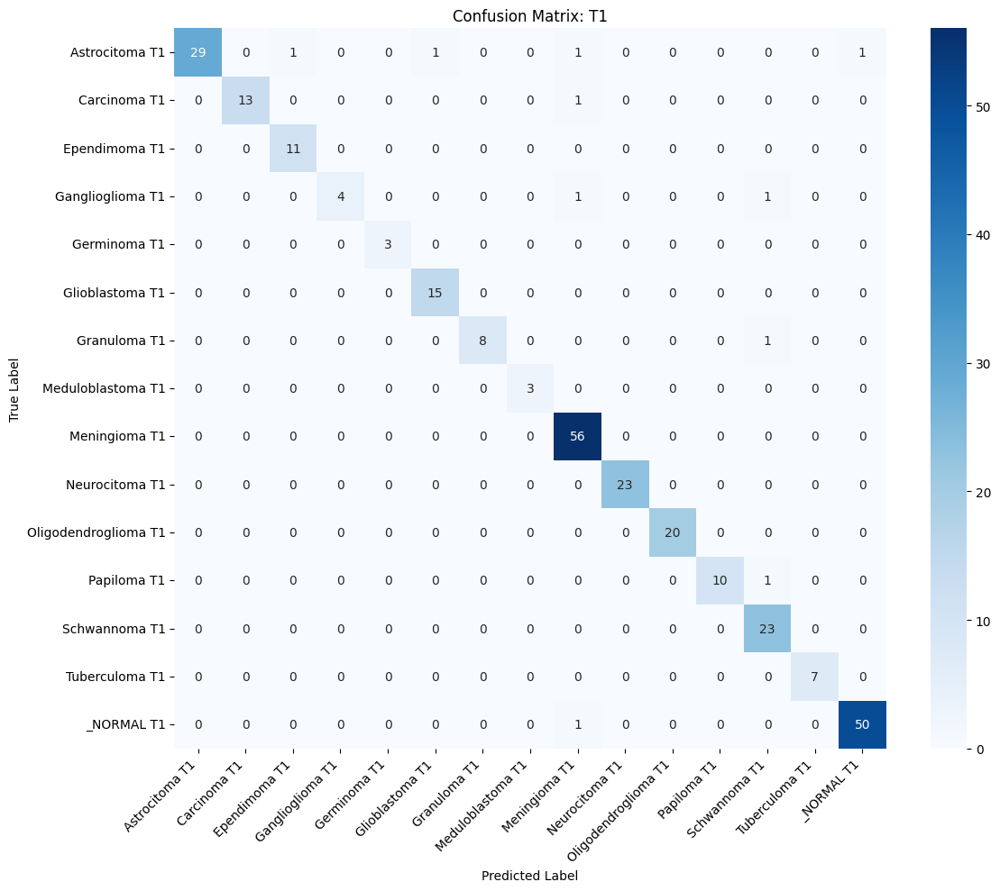


🎨 Generating XAI Visualizations (1 Correct / 1 Incorrect per Class)...

--- Analyzing Class: Astrocitoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


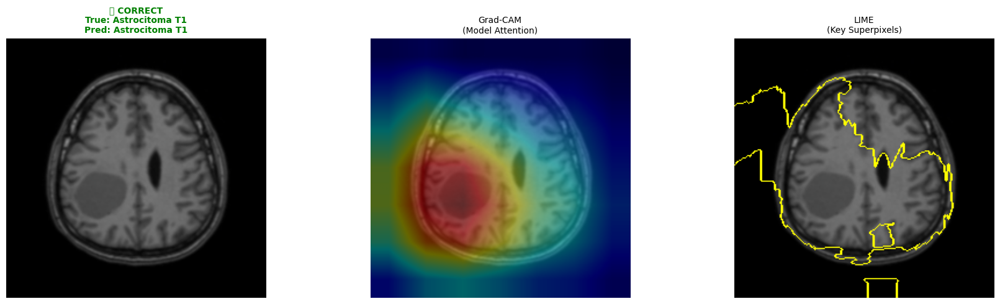

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


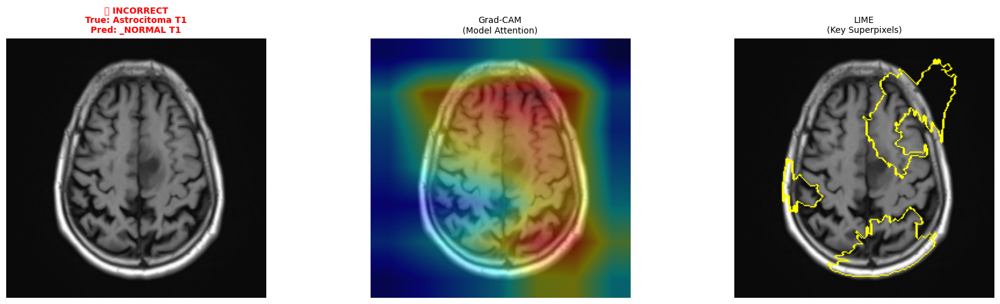


--- Analyzing Class: Carcinoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


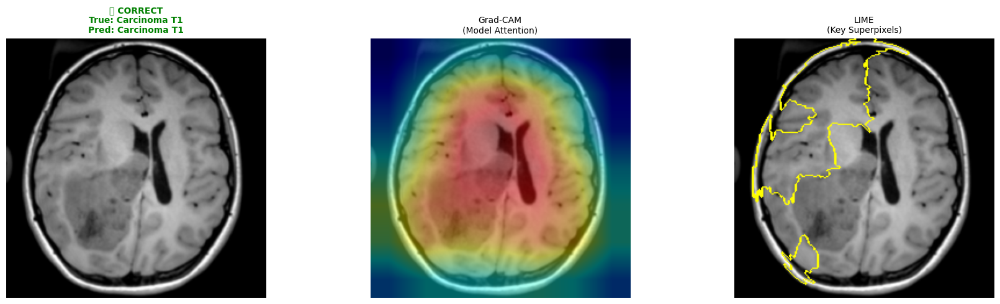

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


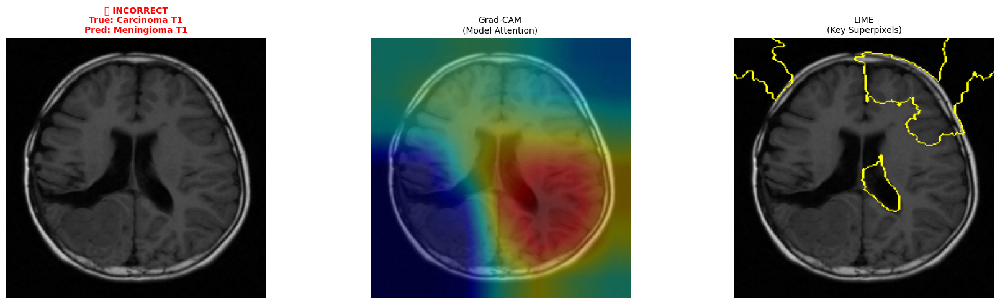


--- Analyzing Class: Ependimoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


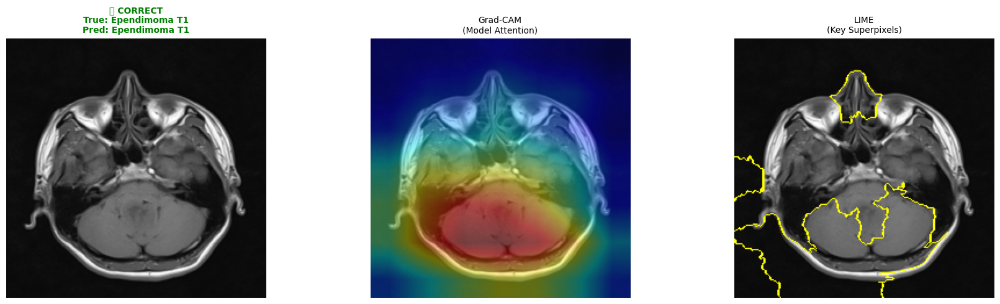

   (No INCORRECT examples found for Ependimoma T1 - Perfect Accuracy!)

--- Analyzing Class: Ganglioglioma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


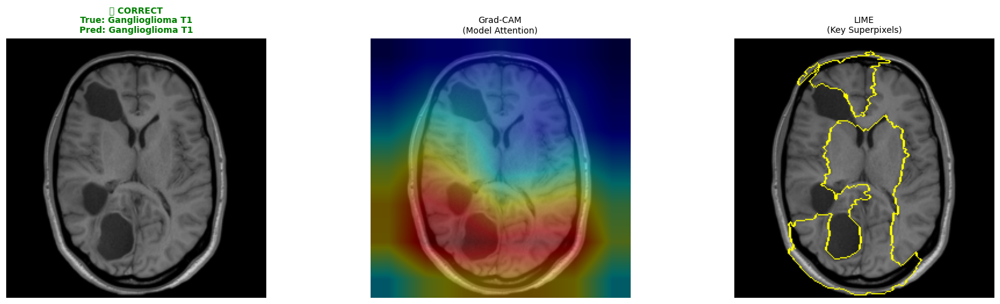

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


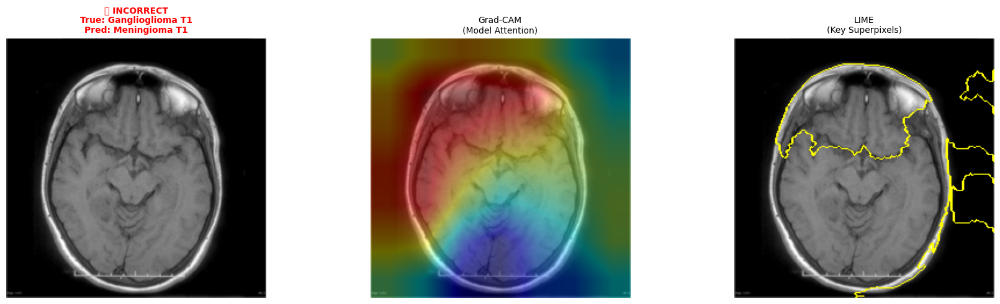


--- Analyzing Class: Germinoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


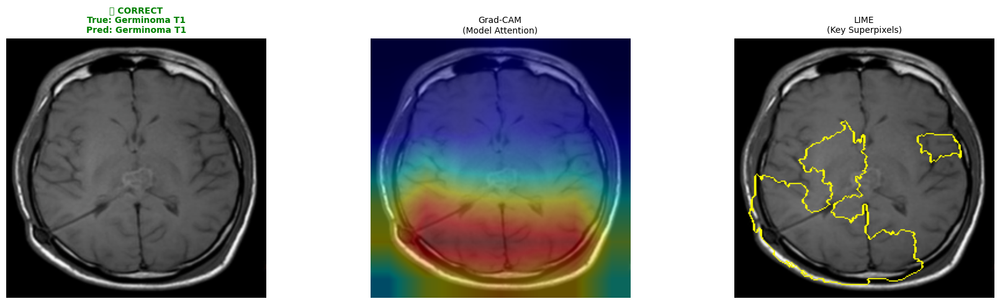

   (No INCORRECT examples found for Germinoma T1 - Perfect Accuracy!)

--- Analyzing Class: Glioblastoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


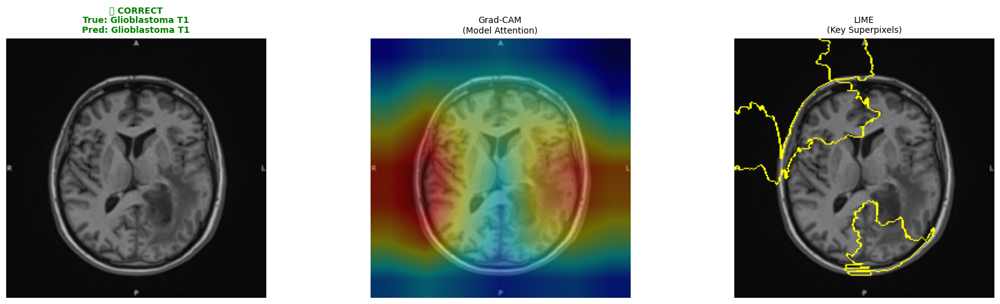

   (No INCORRECT examples found for Glioblastoma T1 - Perfect Accuracy!)

--- Analyzing Class: Granuloma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


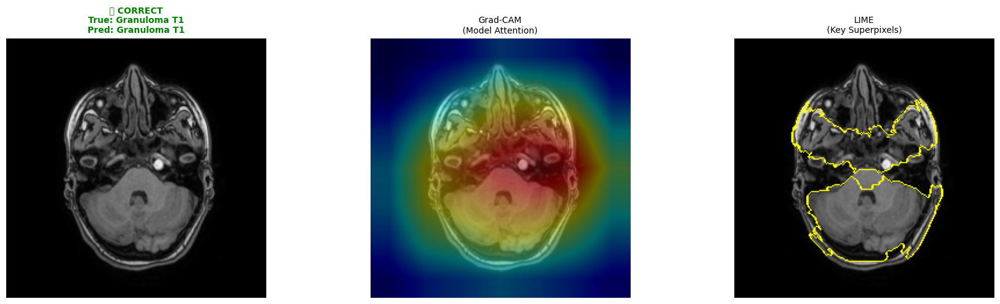

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


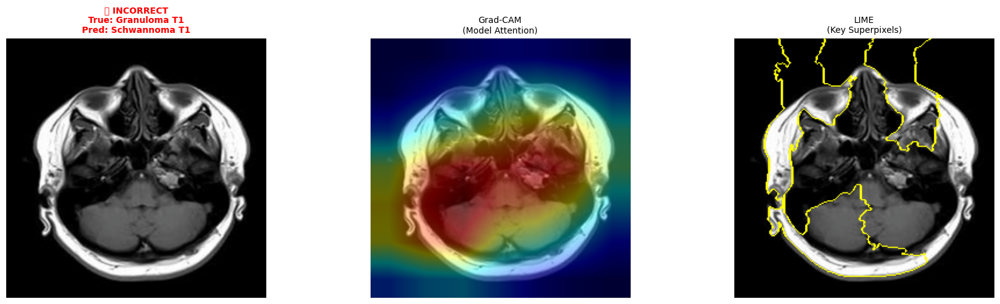


--- Analyzing Class: Meduloblastoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


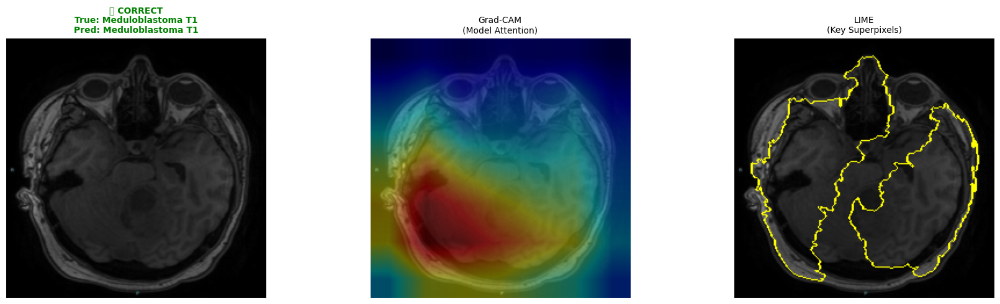

   (No INCORRECT examples found for Meduloblastoma T1 - Perfect Accuracy!)

--- Analyzing Class: Meningioma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


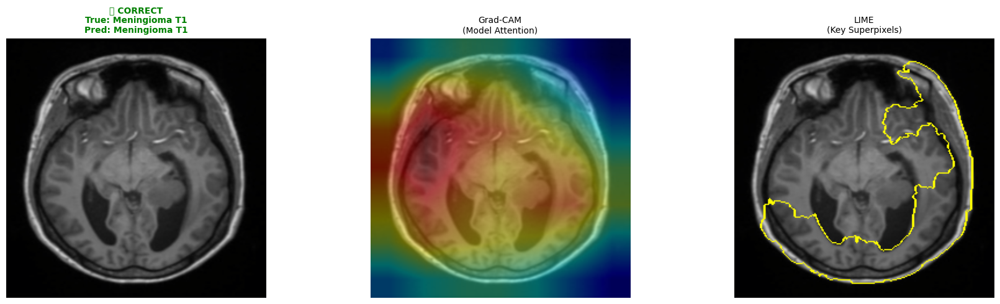

   (No INCORRECT examples found for Meningioma T1 - Perfect Accuracy!)

--- Analyzing Class: Neurocitoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


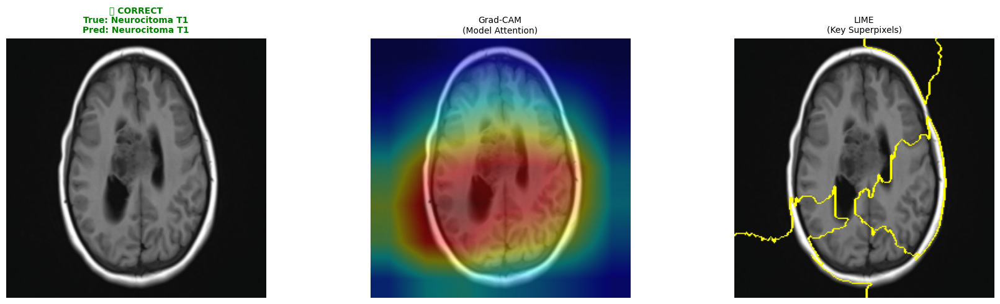

   (No INCORRECT examples found for Neurocitoma T1 - Perfect Accuracy!)

--- Analyzing Class: Oligodendroglioma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


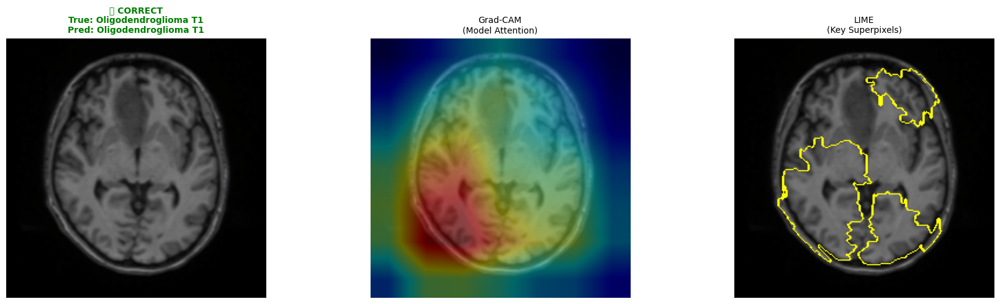

   (No INCORRECT examples found for Oligodendroglioma T1 - Perfect Accuracy!)

--- Analyzing Class: Papiloma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


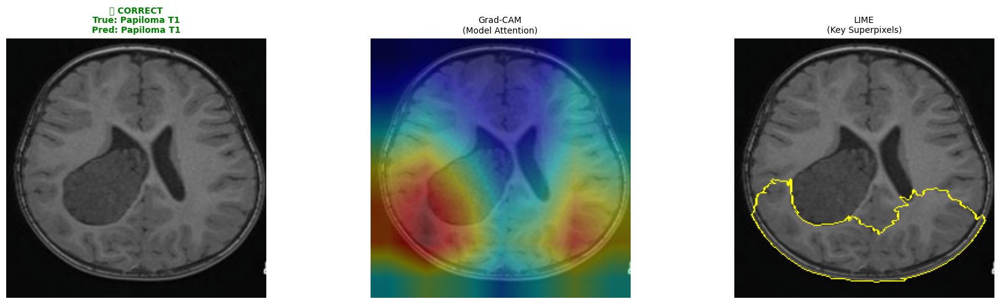

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


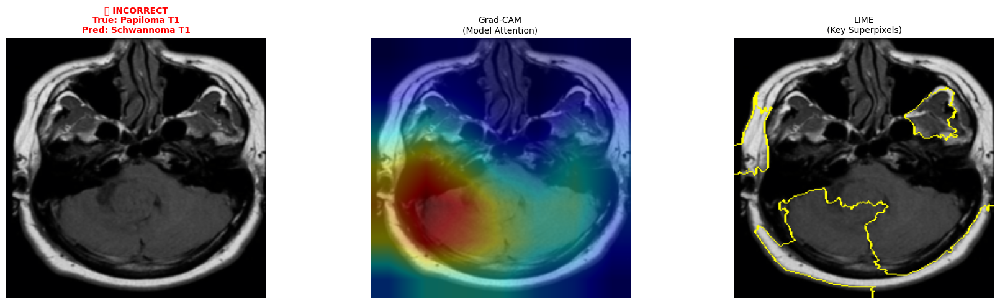


--- Analyzing Class: Schwannoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


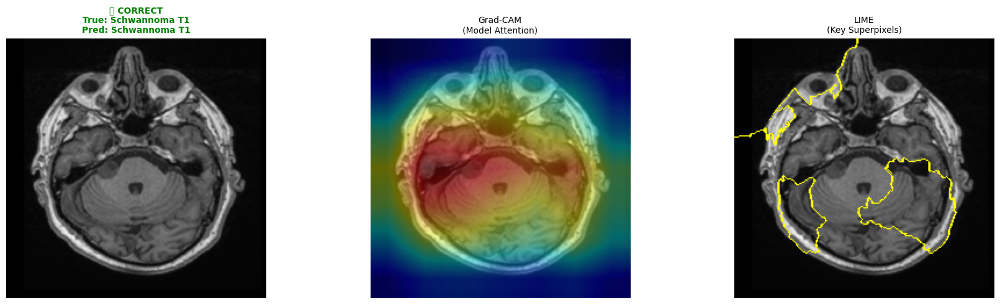

   (No INCORRECT examples found for Schwannoma T1 - Perfect Accuracy!)

--- Analyzing Class: Tuberculoma T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


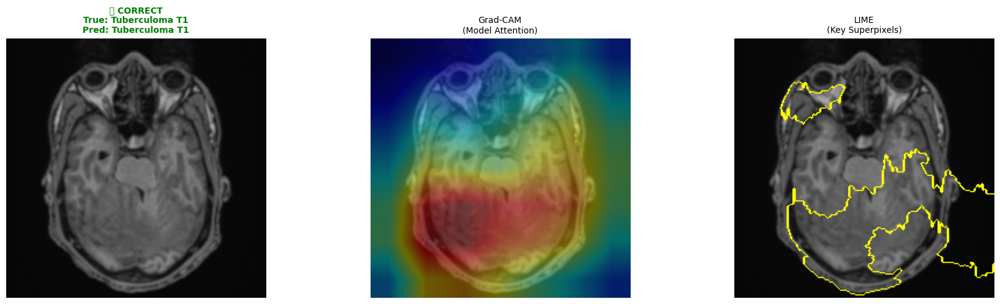

   (No INCORRECT examples found for Tuberculoma T1 - Perfect Accuracy!)

--- Analyzing Class: _NORMAL T1 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


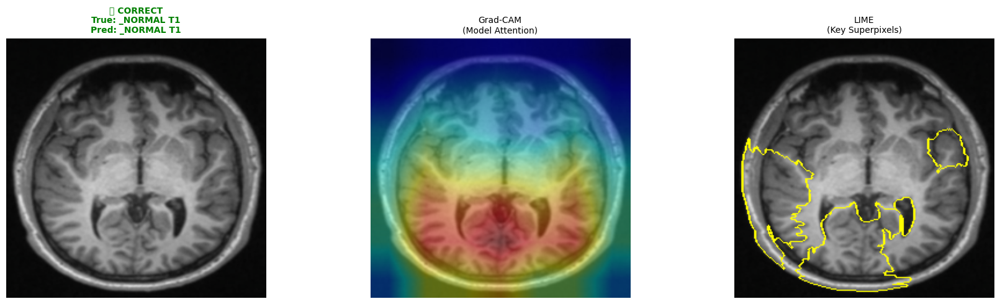

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


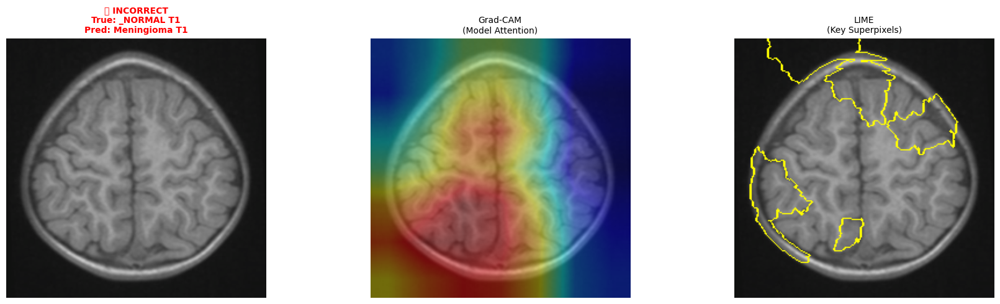

✅ Analysis Complete for T1

🚀 RUNNING EXPERIMENT: T1C+
   Classes (14): ['Astrocitoma T1C+', 'Carcinoma T1C+', 'Ependimoma T1C+', 'Ganglioglioma T1C+', 'Germinoma T1C+', 'Glioblastoma T1C+', 'Granuloma T1C+', 'Meduloblastoma T1C+', 'Meningioma T1C+', 'Neurocitoma T1C+', 'Oligodendroglioma T1C+', 'Papiloma T1C+', 'Schwannoma T1C+', 'Tuberculoma T1C+']
   Train Size: 1354 | Val Size: 339
Epoch [1/5], Loss: 1.0735
Epoch [2/5], Loss: 0.1943
Epoch [3/5], Loss: 0.0437
Epoch [4/5], Loss: 0.0224
Epoch [5/5], Loss: 0.0120

🔍 STARTING COMPREHENSIVE ANALYSIS: T1C+
   Scanning validation set for Correct/Incorrect examples...

📊 Classification Report: T1C+
                        precision    recall  f1-score   support

      Astrocitoma T1C+       0.98      0.92      0.95        65
        Carcinoma T1C+       0.94      1.00      0.97        15
       Ependimoma T1C+       0.88      0.88      0.88         8
    Ganglioglioma T1C+       1.00      0.33      0.50         3
        Germinoma T1C+     

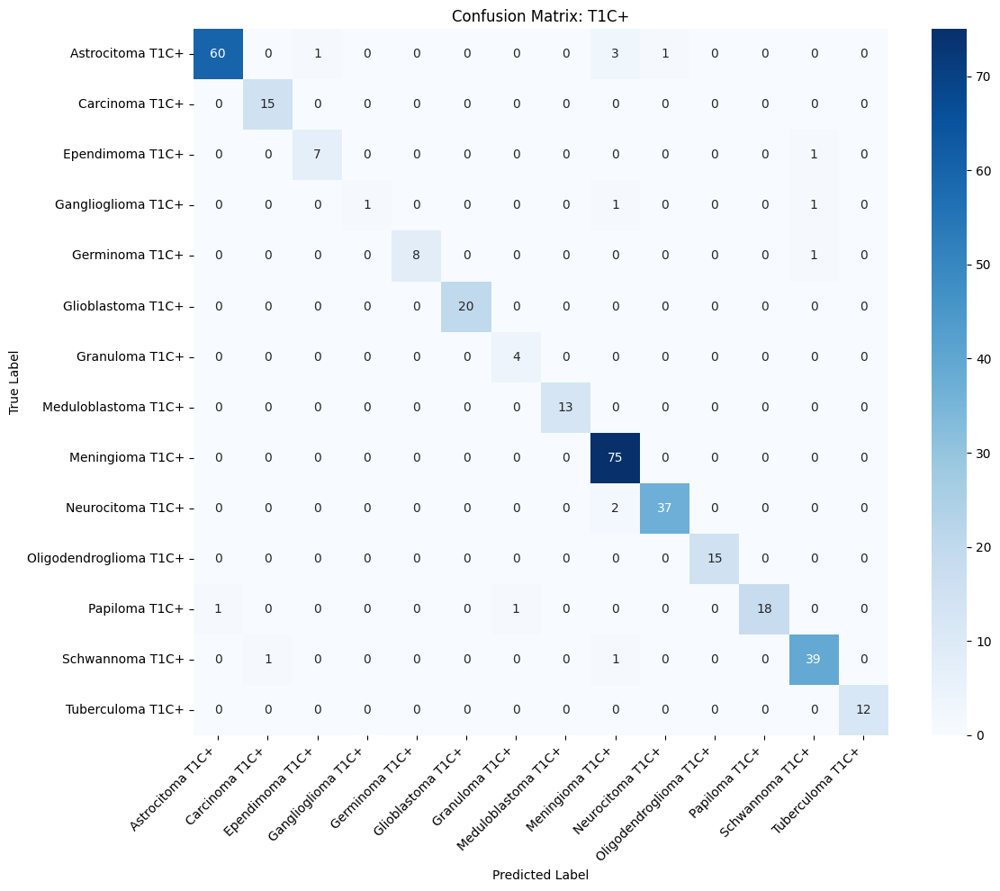


🎨 Generating XAI Visualizations (1 Correct / 1 Incorrect per Class)...

--- Analyzing Class: Astrocitoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


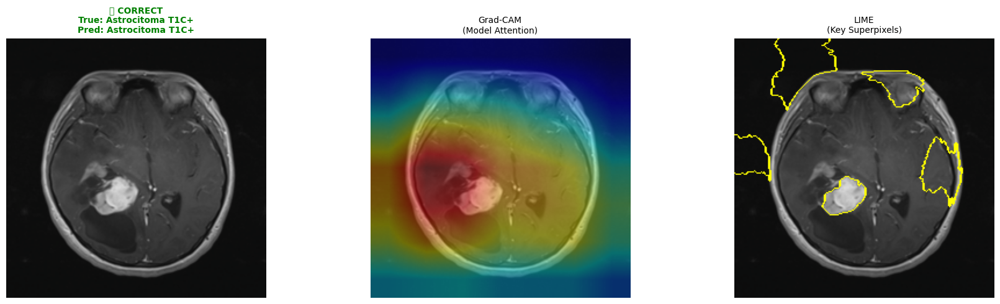

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


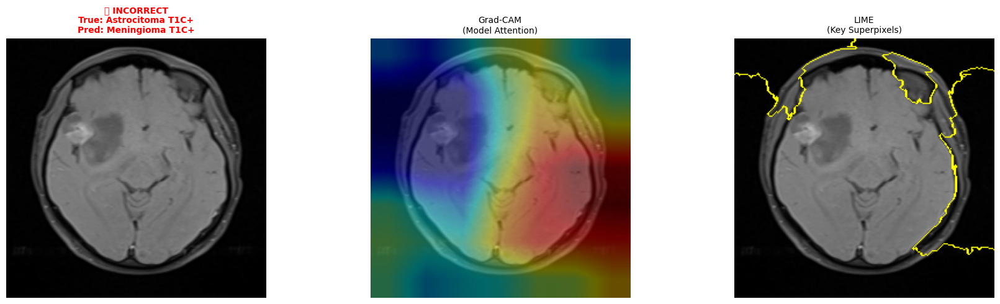


--- Analyzing Class: Carcinoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


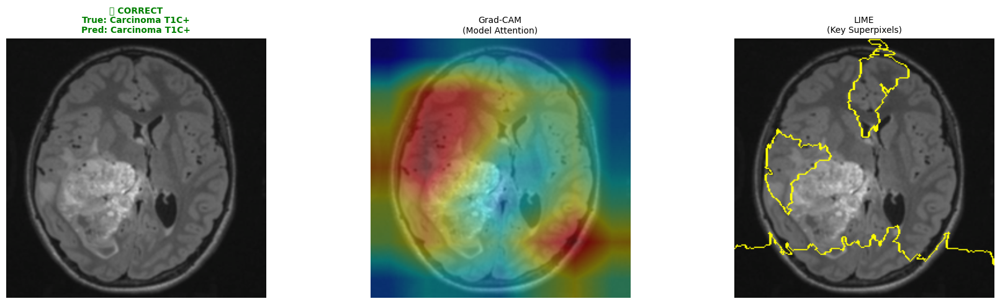

   (No INCORRECT examples found for Carcinoma T1C+ - Perfect Accuracy!)

--- Analyzing Class: Ependimoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


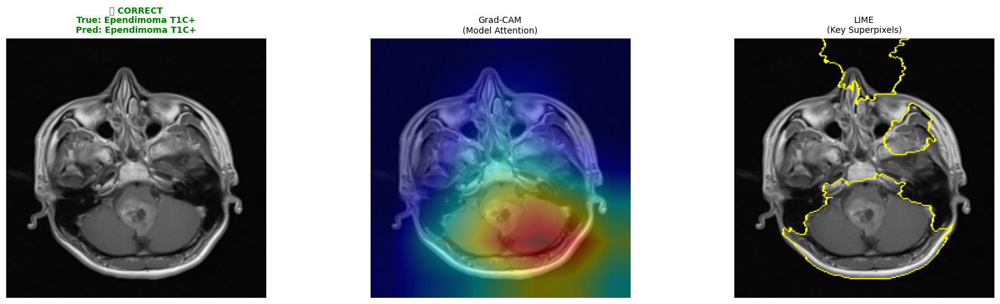

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


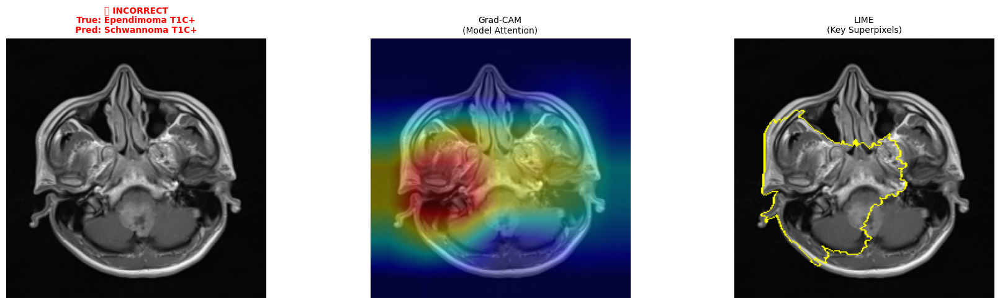


--- Analyzing Class: Ganglioglioma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


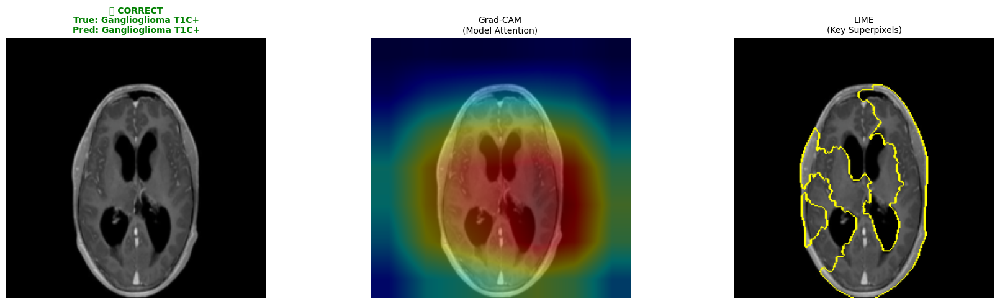

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


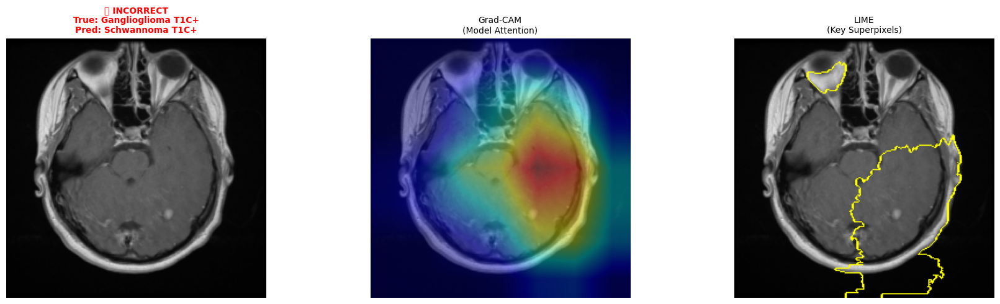


--- Analyzing Class: Germinoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


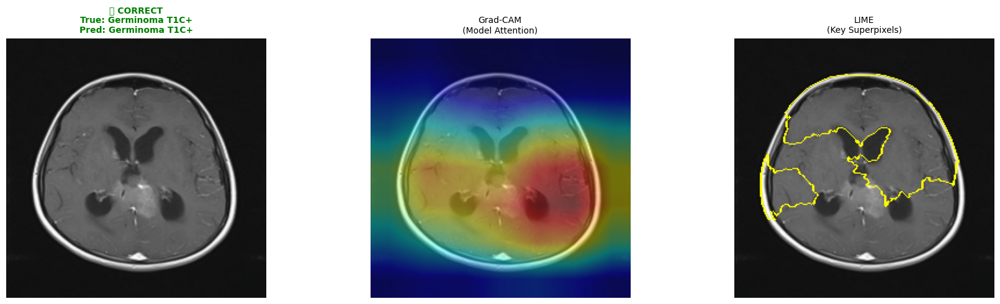

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


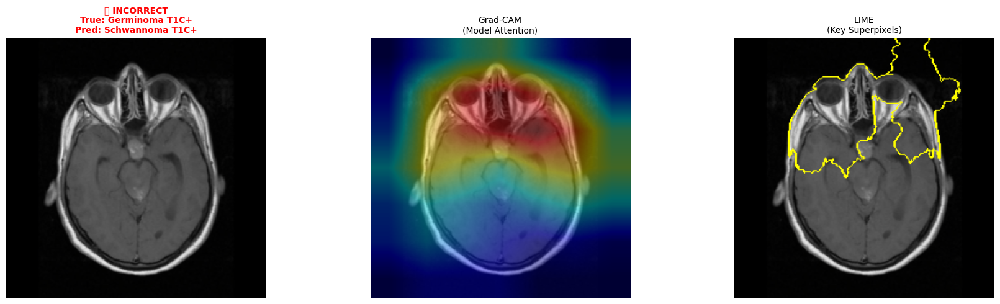


--- Analyzing Class: Glioblastoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


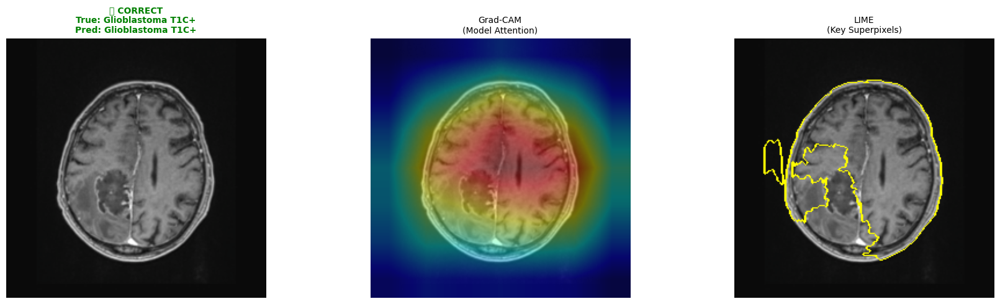

   (No INCORRECT examples found for Glioblastoma T1C+ - Perfect Accuracy!)

--- Analyzing Class: Granuloma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


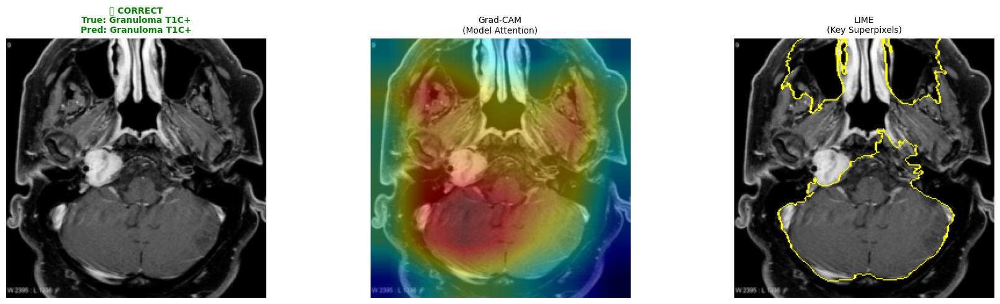

   (No INCORRECT examples found for Granuloma T1C+ - Perfect Accuracy!)

--- Analyzing Class: Meduloblastoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


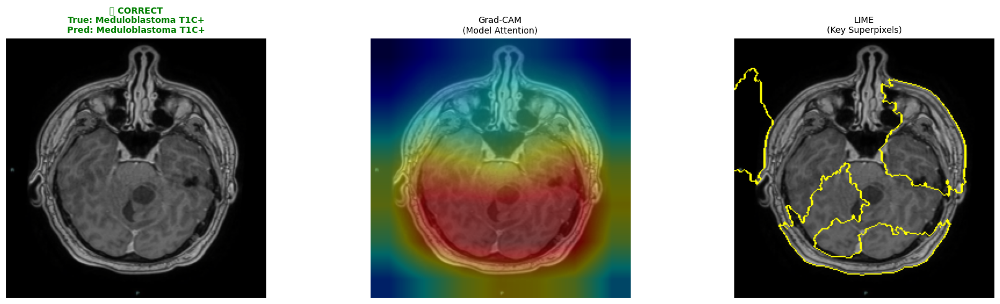

   (No INCORRECT examples found for Meduloblastoma T1C+ - Perfect Accuracy!)

--- Analyzing Class: Meningioma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


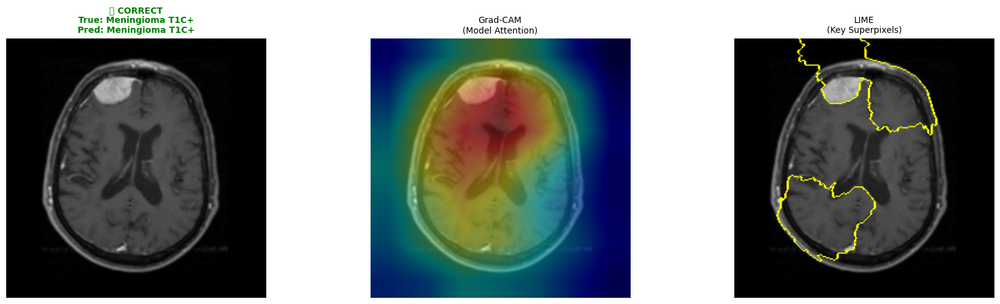

   (No INCORRECT examples found for Meningioma T1C+ - Perfect Accuracy!)

--- Analyzing Class: Neurocitoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


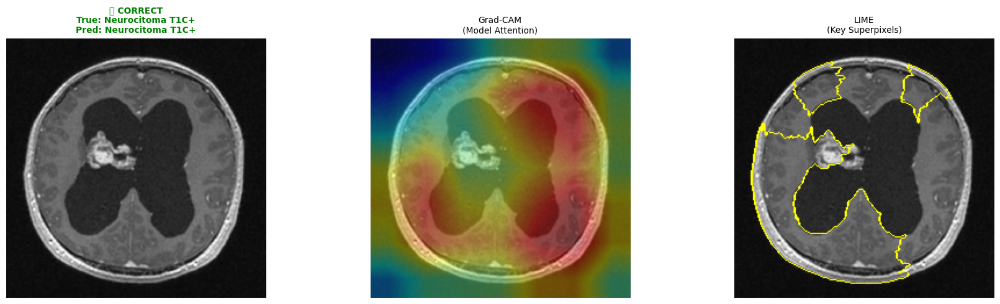

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


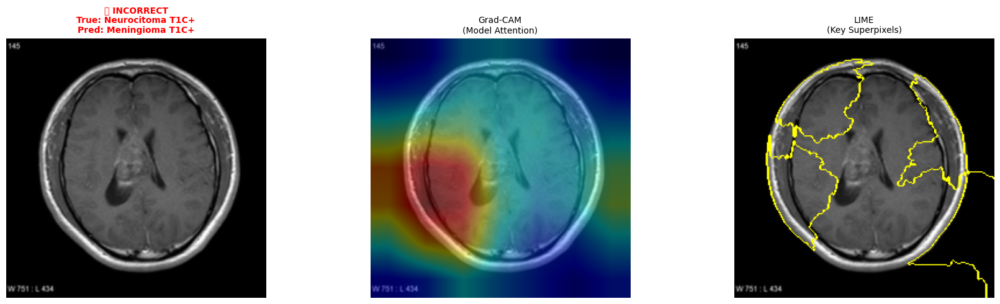


--- Analyzing Class: Oligodendroglioma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


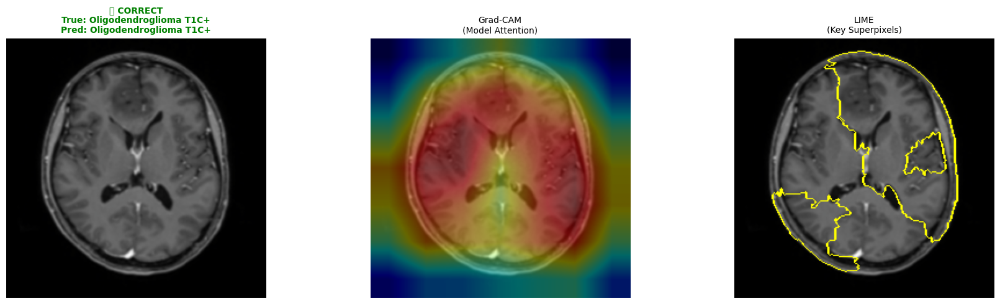

   (No INCORRECT examples found for Oligodendroglioma T1C+ - Perfect Accuracy!)

--- Analyzing Class: Papiloma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


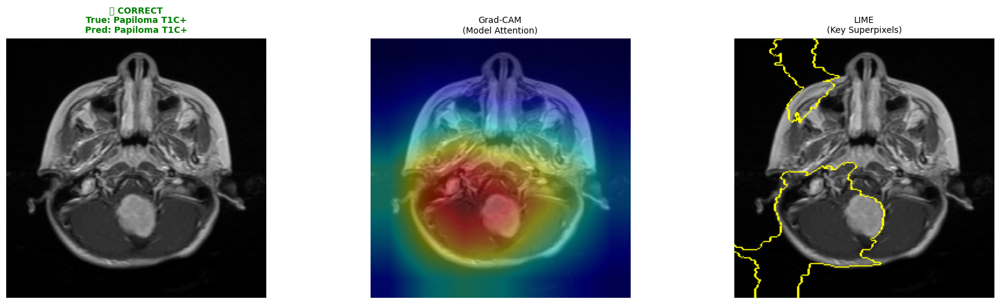

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


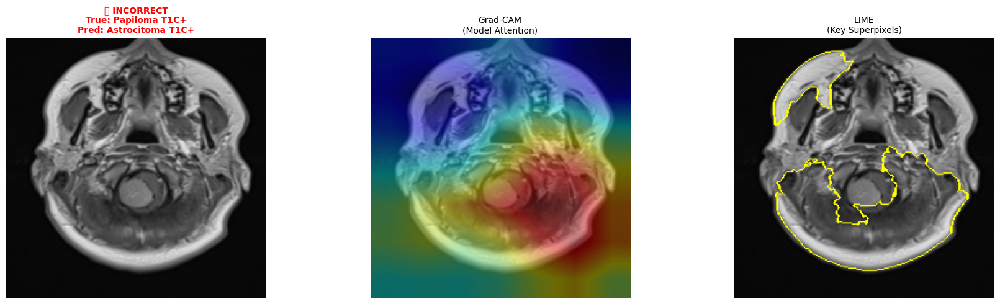


--- Analyzing Class: Schwannoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


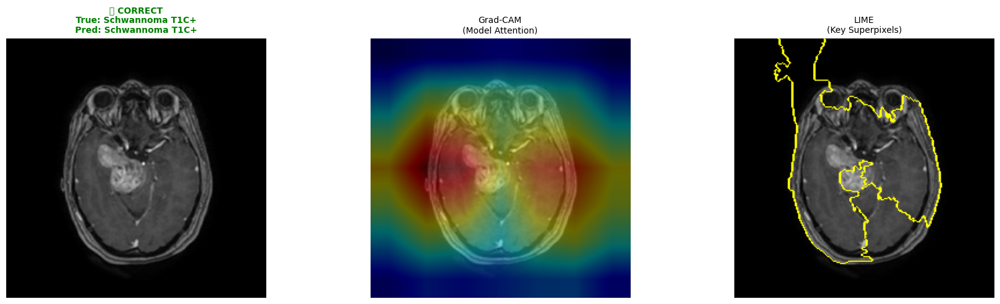

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


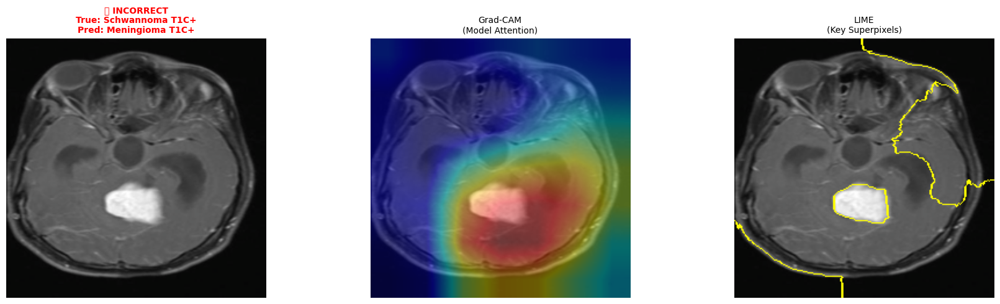


--- Analyzing Class: Tuberculoma T1C+ ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


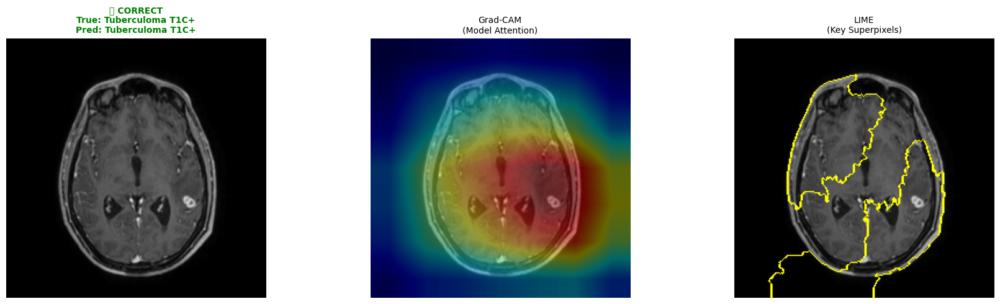

   (No INCORRECT examples found for Tuberculoma T1C+ - Perfect Accuracy!)
✅ Analysis Complete for T1C+

🚀 RUNNING EXPERIMENT: T2
   Classes (15): ['Astrocitoma T2', 'Carcinoma T2', 'Ependimoma T2', 'Ganglioglioma T2', 'Germinoma T2', 'Glioblastoma T2', 'Granuloma T2', 'Meduloblastoma T2', 'Meningioma T2', 'Neurocitoma T2', 'Oligodendroglioma T2', 'Papiloma T2', 'Schwannoma T2', 'Tuberculoma T2', '_NORMAL T2']
   Train Size: 1090 | Val Size: 273
Epoch [1/5], Loss: 1.5730
Epoch [2/5], Loss: 0.4226
Epoch [3/5], Loss: 0.1295
Epoch [4/5], Loss: 0.0736
Epoch [5/5], Loss: 0.0707

🔍 STARTING COMPREHENSIVE ANALYSIS: T2
   Scanning validation set for Correct/Incorrect examples...

📊 Classification Report: T2
                      precision    recall  f1-score   support

      Astrocitoma T2       0.83      0.83      0.83        35
        Carcinoma T2       1.00      0.92      0.96        12
       Ependimoma T2       0.93      0.87      0.90        15
    Ganglioglioma T2       1.00      0.80  

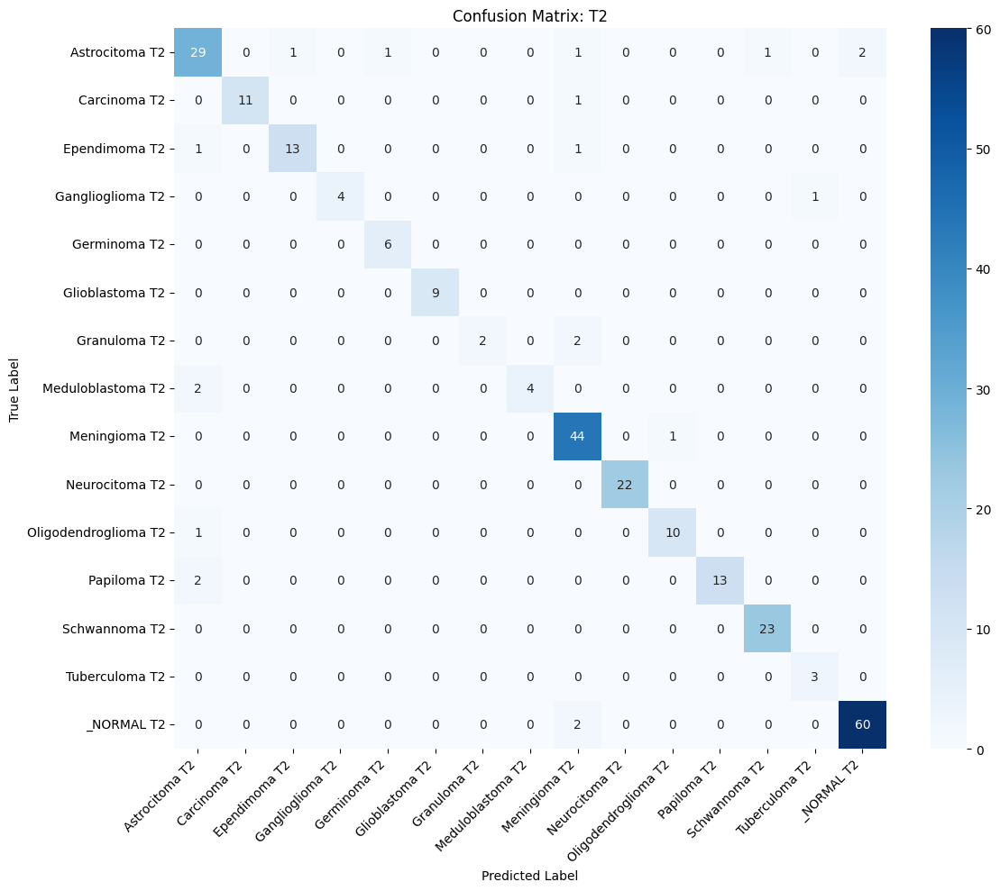


🎨 Generating XAI Visualizations (1 Correct / 1 Incorrect per Class)...

--- Analyzing Class: Astrocitoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


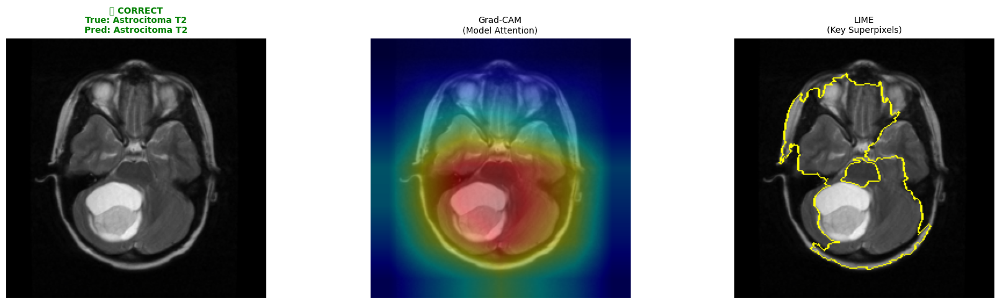

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


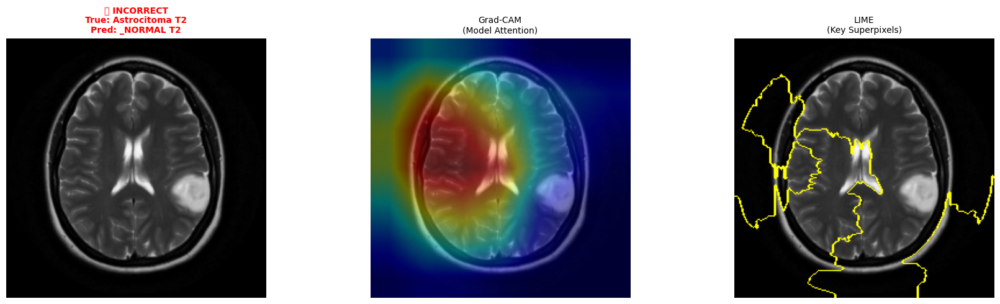


--- Analyzing Class: Carcinoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


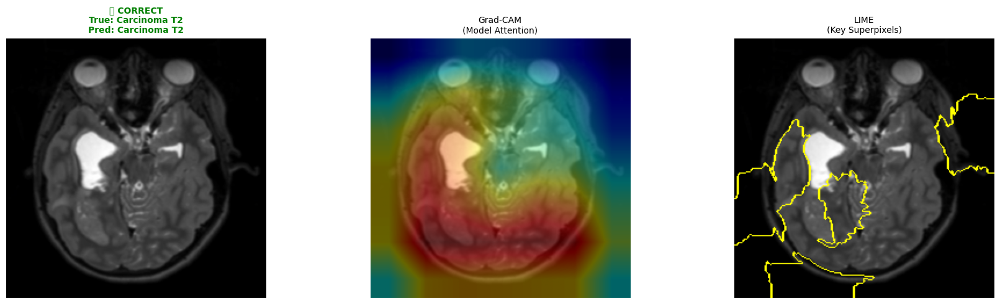

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


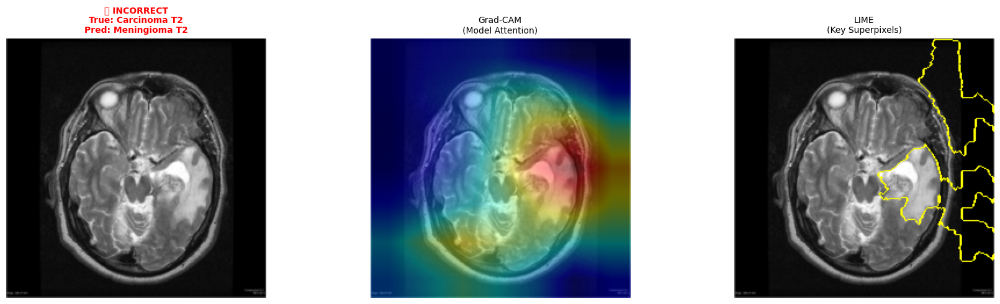


--- Analyzing Class: Ependimoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


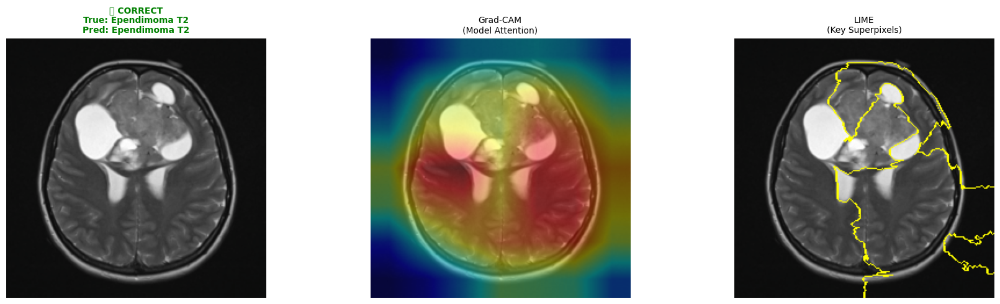

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


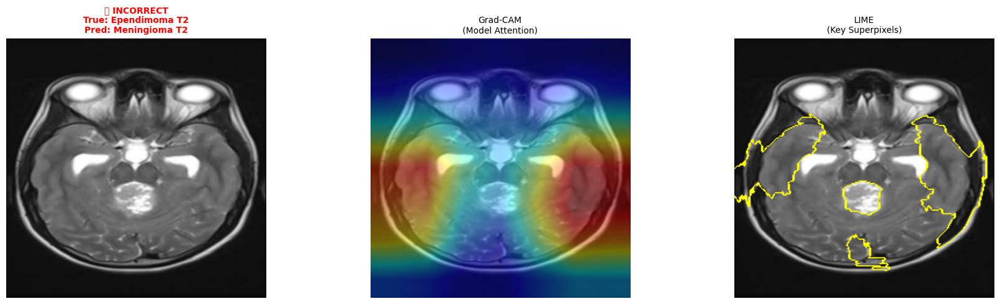


--- Analyzing Class: Ganglioglioma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


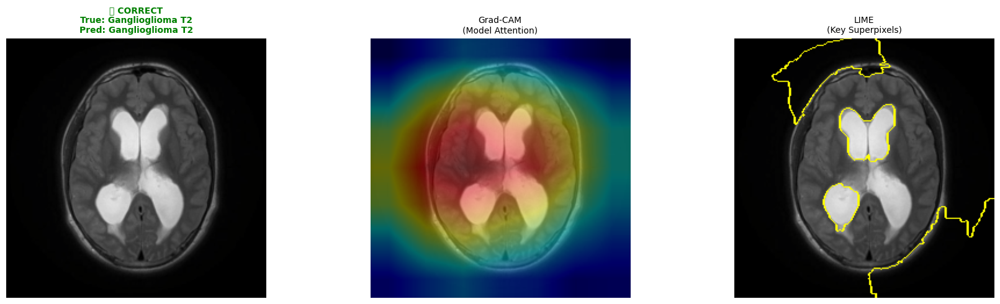

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


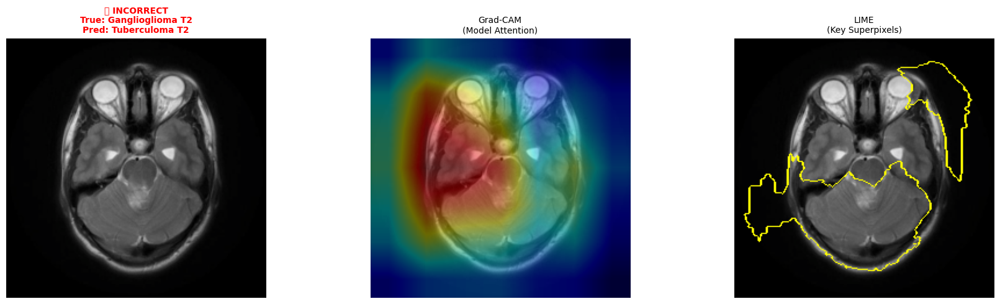


--- Analyzing Class: Germinoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


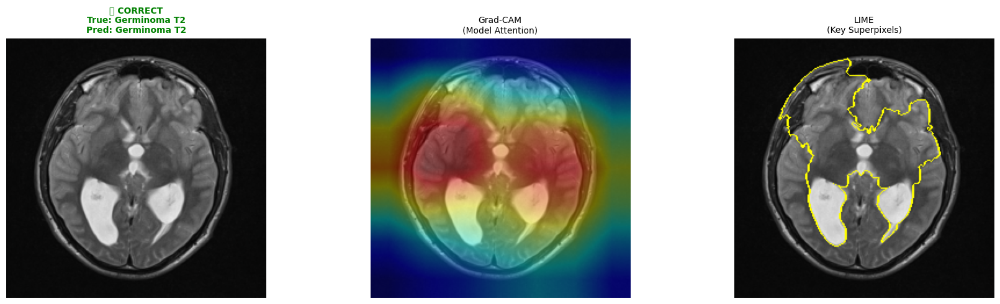

   (No INCORRECT examples found for Germinoma T2 - Perfect Accuracy!)

--- Analyzing Class: Glioblastoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


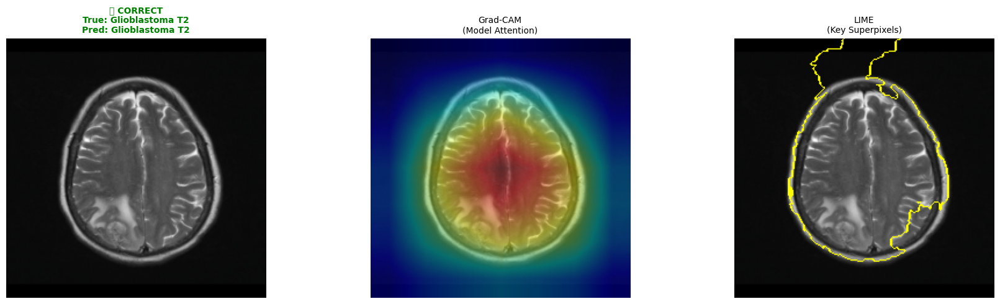

   (No INCORRECT examples found for Glioblastoma T2 - Perfect Accuracy!)

--- Analyzing Class: Granuloma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


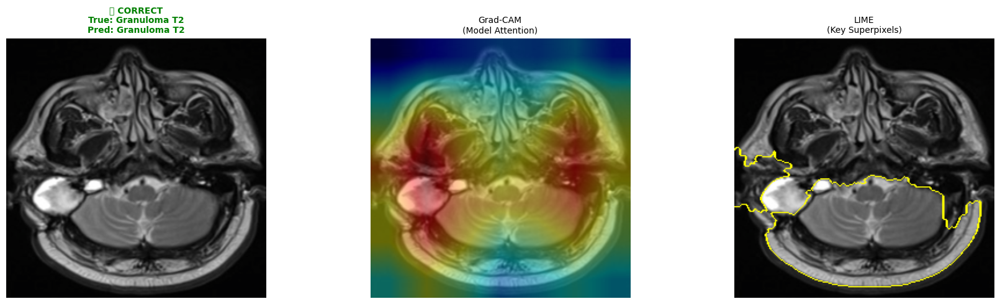

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


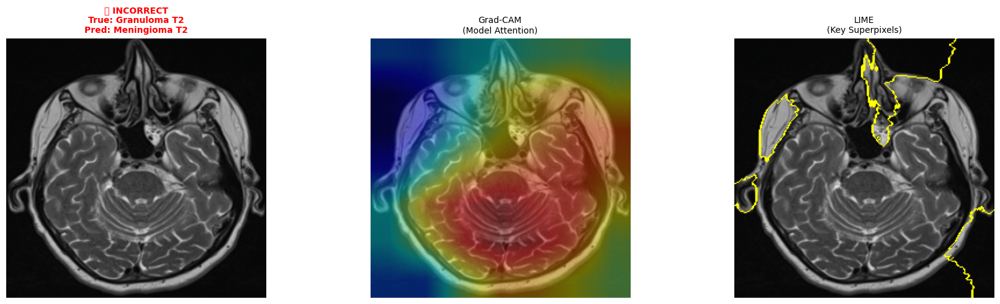


--- Analyzing Class: Meduloblastoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


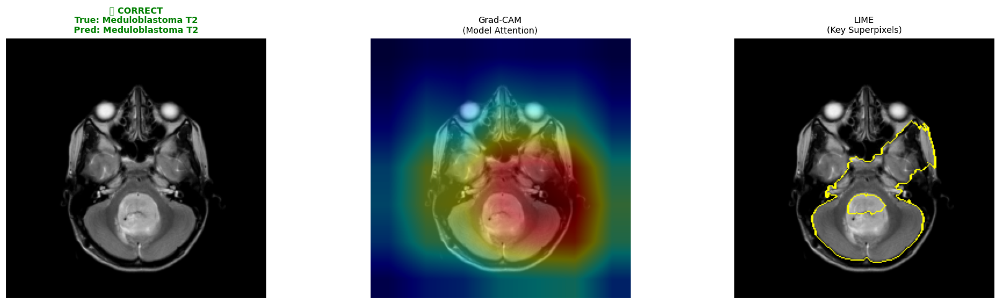

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


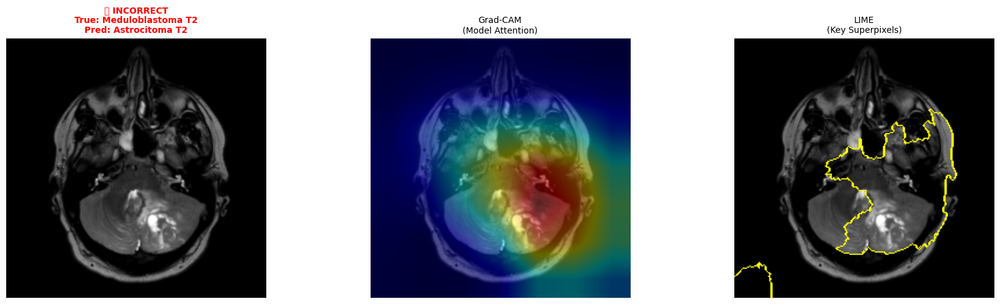


--- Analyzing Class: Meningioma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


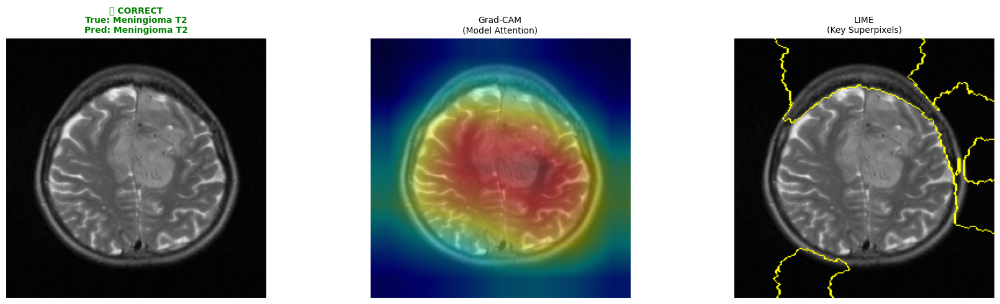

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


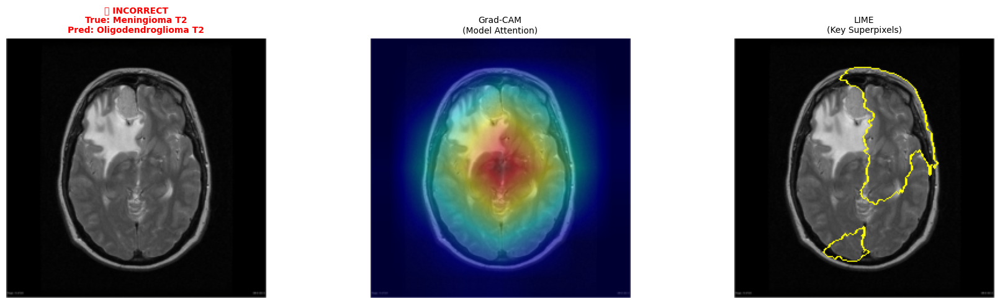


--- Analyzing Class: Neurocitoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


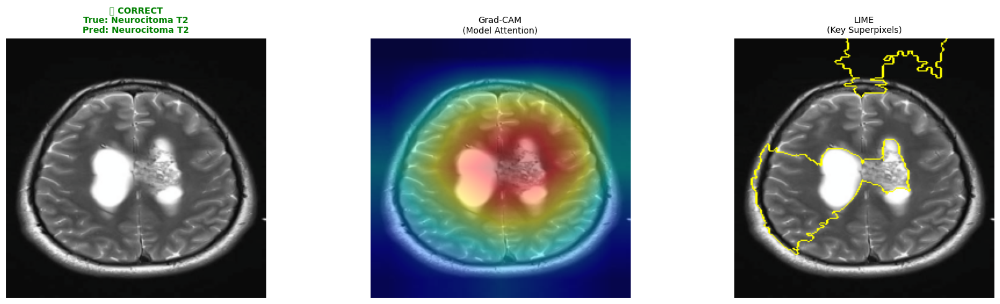

   (No INCORRECT examples found for Neurocitoma T2 - Perfect Accuracy!)

--- Analyzing Class: Oligodendroglioma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


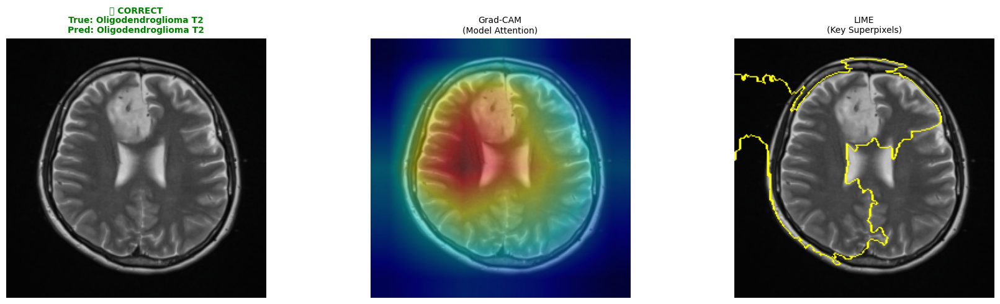

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


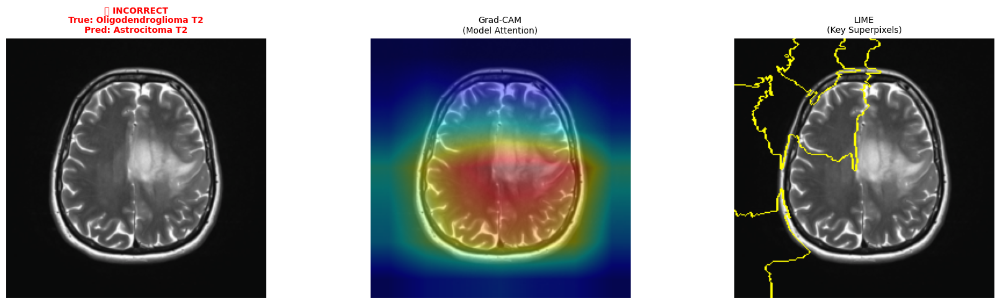


--- Analyzing Class: Papiloma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


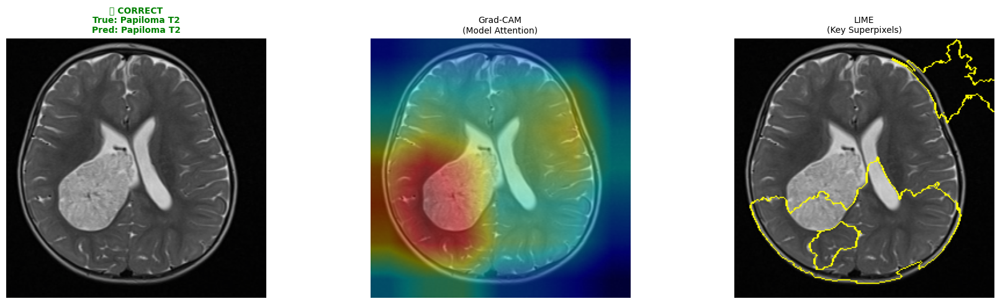

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


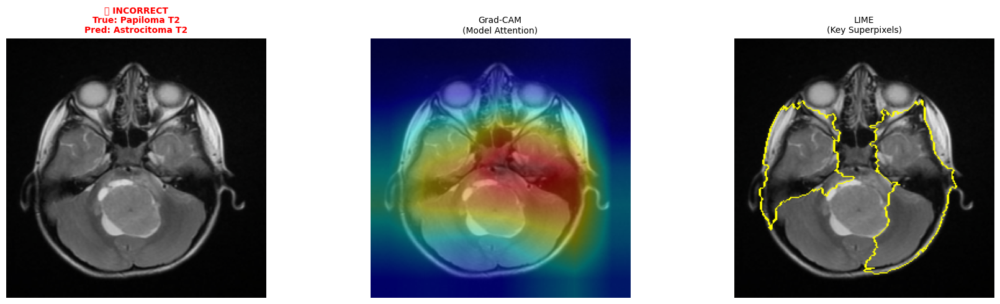


--- Analyzing Class: Schwannoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


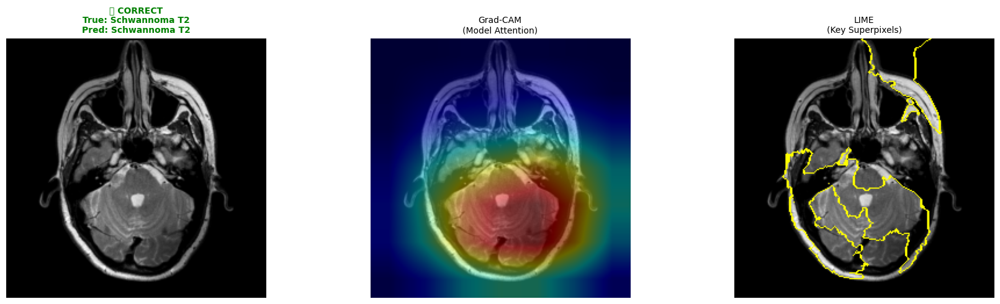

   (No INCORRECT examples found for Schwannoma T2 - Perfect Accuracy!)

--- Analyzing Class: Tuberculoma T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


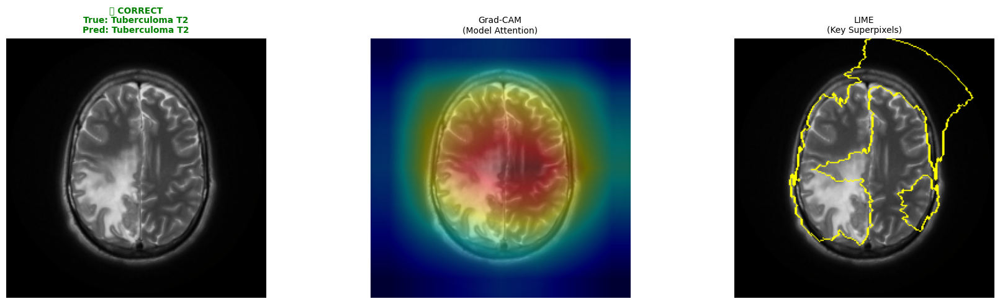

   (No INCORRECT examples found for Tuberculoma T2 - Perfect Accuracy!)

--- Analyzing Class: _NORMAL T2 ---


  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


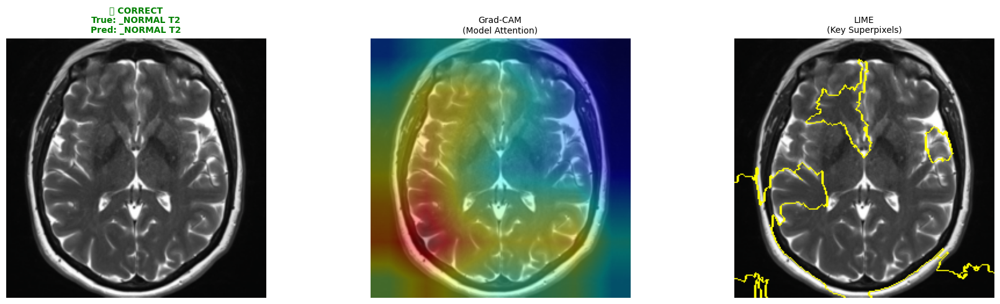

  0%|          | 0/200 [00:00<?, ?it/s]

/tmp/ipython-input-2001221383.py:134: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 10060 (\N{CROSS MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


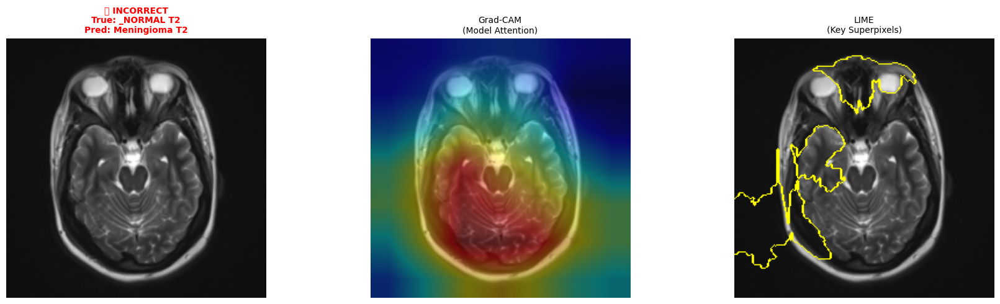

✅ Analysis Complete for T2


In [ ]:
!pip install lime
import torch
import torch.nn as nn
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import random
from sklearn.metrics import confusion_matrix, classification_report
from lime import lime_image
from skimage.segmentation import mark_boundaries

# ---------------------------------------------------------
# 1. HELPER CLASSES & CONFIG
# ---------------------------------------------------------
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Standard ImageNet normalization for denormalizing plots
MEAN = np.array([0.485, 0.456, 0.406])
STD = np.array([0.229, 0.224, 0.225])

class GradCAM:
    """Calculates Grad-CAM for a given model and target layer."""
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None

        # Hooks to capture data during forward/backward pass
        self.handle_fwd = self.target_layer.register_forward_hook(self.save_activation)
        self.handle_bwd = self.target_layer.register_full_backward_hook(self.save_gradient)

    def save_activation(self, module, input, output):
        self.activations = output

    def save_gradient(self, module, grad_input, grad_output):
        self.gradients = grad_output[0]

    def generate(self, input_tensor, class_idx):
        self.model.zero_grad()
        output = self.model(input_tensor)
        score = output[0, class_idx]
        score.backward()

        # Pool gradients across channels
        weights = torch.mean(self.gradients, dim=(2, 3), keepdim=True)
        # Weight the activations
        cam = torch.sum(weights * self.activations, dim=1).squeeze().detach().cpu().numpy()

        # ReLU and Resize
        cam = np.maximum(cam, 0)
        cam = cv2.resize(cam, (224, 224))

        # Normalize to 0-1
        cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
        return cam

    def remove_hooks(self):
        self.handle_fwd.remove()
        self.handle_bwd.remove()

# Initialize LIME Explainer
explainer = lime_image.LimeImageExplainer()

# ---------------------------------------------------------
# 2. VISUALIZATION ENGINE
# ---------------------------------------------------------
def generate_xai_plots(model, img_tensor, true_label, pred_label, class_names, cam_extractor, title_prefix):
    """Generates and plots Original, Grad-CAM, and LIME side-by-side."""

    # A. Prepare Image for Display (Un-normalize)
    input_tensor = img_tensor.unsqueeze(0).to(DEVICE)
    disp_img = img_tensor.permute(1, 2, 0).cpu().numpy() * STD + MEAN
    disp_img = np.clip(disp_img, 0, 1)

    # B. Generate Grad-CAM (Targeting the PREDICTED class to explain the decision)
    cam_mask = cam_extractor.generate(input_tensor, pred_label)
    heatmap = cv2.applyColorMap(np.uint8(255 * cam_mask), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB) / 255.0
    cam_overlay = heatmap * 0.4 + disp_img * 0.6

    # C. Generate LIME
    def lime_predict_fn(images):
        # LIME passes a numpy array (N, H, W, C) in double format
        # We must convert to Tensor (N, C, H, W), Float32, and Normalize
        batch_t = []
        for i in images:
            t = torch.tensor(i, dtype=torch.float32).permute(2, 0, 1)
            t = (t - torch.tensor(MEAN, dtype=torch.float32).view(3,1,1)) / torch.tensor(STD, dtype=torch.float32).view(3,1,1)
            batch_t.append(t)

        batch_t = torch.stack(batch_t).to(DEVICE)

        model.eval()
        with torch.no_grad():
            logits = model(batch_t)
            probs = torch.softmax(logits, dim=1)
        return probs.cpu().numpy()

    # Explain the top prediction
    explanation = explainer.explain_instance(
        disp_img.astype('double'),
        lime_predict_fn,
        top_labels=1,
        hide_color=0,
        num_samples=200  # Lower samples for speed; increase to 1000 for high quality
    )
    temp, mask = explanation.get_image_and_mask(
        explanation.top_labels[0], positive_only=True, num_features=5, hide_rest=False
    )
    lime_overlay = mark_boundaries(temp, mask)

    # D. Plotting
    fig, axes = plt.subplots(1, 3, figsize=(18, 5))

    # 1. Original Image with Labels
    color = 'green' if true_label == pred_label else 'red'
    axes[0].imshow(disp_img)
    axes[0].set_title(f"{title_prefix}\nTrue: {class_names[true_label]}\nPred: {class_names[pred_label]}",
                      color=color, fontweight='bold', fontsize=10)
    axes[0].axis('off')

    # 2. Grad-CAM
    axes[1].imshow(cam_overlay)
    axes[1].set_title(f"Grad-CAM\n(Model Attention)", fontsize=10)
    axes[1].axis('off')

    # 3. LIME
    axes[2].imshow(lime_overlay)
    axes[2].set_title(f"LIME\n(Key Superpixels)", fontsize=10)
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

# ---------------------------------------------------------
# 3. MAIN EVALUATION FUNCTION
# ---------------------------------------------------------
def visualize_comprehensive_performance(model, val_dataset, class_names, modality_name):
    print(f"\n🔍 STARTING COMPREHENSIVE ANALYSIS: {modality_name}")
    model.eval()

    # --- Step 1: Metrics & Confusion Matrix ---
    all_preds = []
    all_labels = []

    # Dictionaries to store indices of examples: {class_idx: {'correct': idx, 'incorrect': idx}}
    example_indices = {i: {'correct': None, 'incorrect': None} for i in range(len(class_names))}

    print("   Scanning validation set for Correct/Incorrect examples...")
    for i in range(len(val_dataset)):
        img, label = val_dataset[i]
        img_tensor = img.unsqueeze(0).to(DEVICE)

        with torch.no_grad():
            output = model(img_tensor)
            pred = torch.argmax(output, 1).item()

        all_preds.append(pred)
        all_labels.append(label)

        # Save indices for XAI (One correct, One incorrect per class)
        if pred == label:
            if example_indices[label]['correct'] is None:
                example_indices[label]['correct'] = i
        else:
            if example_indices[label]['incorrect'] is None:
                example_indices[label]['incorrect'] = (i, pred) # Store predicted label too

    # Print Report
    print(f"\n📊 Classification Report: {modality_name}")
    print(classification_report(all_labels, all_preds, target_names=class_names))

    # Plot Confusion Matrix
    cm = confusion_matrix(all_labels, all_preds)
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
    plt.title(f'Confusion Matrix: {modality_name}')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()
    plt.show()

    # --- Step 2: XAI Visualizations (Loop through classes) ---
    print(f"\n🎨 Generating XAI Visualizations (1 Correct / 1 Incorrect per Class)...")

    # Hook Grad-CAM to the last convolutional layer (usually layer4 for ResNet)
    cam_extractor = GradCAM(model, model.layer4[-1])

    for cls_idx, cls_name in enumerate(class_names):
        print(f"\n--- Analyzing Class: {cls_name} ---")

        # Plot Correct Example
        if example_indices[cls_idx]['correct'] is not None:
            idx = example_indices[cls_idx]['correct']
            img, label = val_dataset[idx]
            generate_xai_plots(model, img, label, label, class_names, cam_extractor, "✅ CORRECT")
        else:
            print(f"   (No CORRECT examples found for {cls_name})")

        # Plot Incorrect Example
        if example_indices[cls_idx]['incorrect'] is not None:
            idx, pred_label = example_indices[cls_idx]['incorrect']
            img, label = val_dataset[idx]
            generate_xai_plots(model, img, label, pred_label, class_names, cam_extractor, "❌ INCORRECT")
        else:
            print(f"   (No INCORRECT examples found for {cls_name} - Perfect Accuracy!)")

    cam_extractor.remove_hooks()
    print(f"✅ Analysis Complete for {modality_name}")

# ---------------------------------------------------------
# 4. EXECTION LOOP
# ---------------------------------------------------------
# Run this block to start the experiment
for modality in [" T1", " T1C+", " T2"]:
    print(f"\n" + "="*50)
    print(f"🚀 RUNNING EXPERIMENT: {modality.strip()}")
    print("="*50)

    # 1. Load Data
    # Assumes get_modality_loaders is defined in your previous cells
    t_loader, v_loader, n_classes, names, val_subset = get_modality_loaders(modality)
    print(f"   Classes ({n_classes}): {names}")
    print(f"   Train Size: {len(t_loader.dataset)} | Val Size: {len(val_subset)}")

    # 2. Train
    # Assumes train_model is defined in your previous cells
    trained_m = train_model(t_loader, n_classes)

    # 3. Comprehensive Evaluation (Metrics + Side-by-Side XAI)
    visualize_comprehensive_performance(trained_m, val_subset, names, modality.strip())